# 압축 파일 해제하기

In [ ]:
!pip install ultralytics opencv-python fpdf

import zipfile
import os

# 압축 파일 경로 (업로드된 파일 이름 사용)
zip_file_path = "/content/drive/MyDrive/face_emotion/new_Selected_file_plus1000_minus500.zip"  # 업로드된 .zip 파일 경로

# 압축 해제할 디렉토리 설정
extract_to = "/content/drive/MyDrive/face_emotion/dataset/" # 압축 해제할 대상 디렉토리

# 폴더 생성 (경로가 없으면 생성)
os.makedirs(extract_to, exist_ok=True)

# zip 파일 열기 및 압축 해제
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f"Files extracted to: {extract_to}")


Files extracted to: /content/drive/MyDrive/face_emotion/dataset/


In [ ]:
import os
import shutil

# 원본 폴더 경로
source_folder = '/content/drive/MyDrive/eyes_detection/eye_data'
# 이동할 대상 폴더 경로
destination_folder = '/content/drive/MyDrive/eyes_detection/dataset/images/'

# 대상 폴더가 없으면 생성
os.makedirs(destination_folder, exist_ok=True)

# .txt 파일 이동
for file_name in os.listdir(source_folder):
    if file_name.endswith('.jpg'):  # 확장자가 .txt인지 확인
        source_path = os.path.join(source_folder, file_name)
        destination_path = os.path.join(destination_folder, file_name)
        shutil.move(source_path, destination_path)  # 파일 이동
        print(f"Moved: {source_path} -> {destination_path}")

print("모든 .txt 파일 이동이 완료되었습니다!")


Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_10279.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_10279.jpg
Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_10291.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_10291.jpg
Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_10281.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_10281.jpg
Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_10280.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_10280.jpg
Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_10330.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_10330.jpg
Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_12567.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_12567.jpg
Moved: /content/drive/MyDrive/eyes_detection/eye_data/front_12555.jpg -> /content/drive/MyDrive/eyes_detection/dataset/images/front_12555.jpg
Moved:

In [ ]:
import os

# labels 디렉토리 경로
labels_dir = "/content/drive/MyDrive/face_emotion/dataset/train/labels"

# 모든 txt 파일 처리
for filename in os.listdir(labels_dir):
    if filename.endswith(".txt") and filename.startswith("natural_"):
        file_path = os.path.join(labels_dir, filename)

        # 파일 읽기
        with open(file_path, 'r') as file:
            lines = file.readlines()

        # 첫 번째 숫자 0을 2로 변경 (natural_숫자.txt 파일만)
        updated_lines = []
        for line in lines:
            parts = line.strip().split()
            if parts:
                parts[0] = '2'  # 클래스 변경
                updated_lines.append(" ".join(parts))

        # 파일 다시 쓰기
        with open(file_path, 'w') as file:
            file.write("\n".join(updated_lines) + "\n")

        print(f"{filename} 처리 완료")


natural_10.txt 처리 완료
natural_100.txt 처리 완료
natural_1000.txt 처리 완료
natural_1001.txt 처리 완료
natural_101.txt 처리 완료
natural_102.txt 처리 완료
natural_103.txt 처리 완료
natural_104.txt 처리 완료
natural_105.txt 처리 완료
natural_106.txt 처리 완료
natural_107.txt 처리 완료
natural_108.txt 처리 완료
natural_109.txt 처리 완료
natural_11.txt 처리 완료
natural_110.txt 처리 완료
natural_111.txt 처리 완료
natural_112.txt 처리 완료
natural_113.txt 처리 완료
natural_114.txt 처리 완료
natural_115.txt 처리 완료
natural_116.txt 처리 완료
natural_117.txt 처리 완료
natural_118.txt 처리 완료
natural_119.txt 처리 완료
natural_12.txt 처리 완료
natural_120.txt 처리 완료
natural_121.txt 처리 완료
natural_122.txt 처리 완료
natural_123.txt 처리 완료
natural_124.txt 처리 완료
natural_125.txt 처리 완료
natural_126.txt 처리 완료
natural_127.txt 처리 완료
natural_128.txt 처리 완료
natural_129.txt 처리 완료
natural_13.txt 처리 완료
natural_130.txt 처리 완료
natural_131.txt 처리 완료
natural_132.txt 처리 완료
natural_133.txt 처리 완료
natural_134.txt 처리 완료
natural_135.txt 처리 완료
natural_136.txt 처리 완료
natural_137.txt 처리 완료
natural_138.txt 처리 완료
natural_139.

In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split

# 원본 이미지와 라벨 디렉토리 경로
train_image_dir = "/content/drive/MyDrive/eyes_detection/dataset/images"
train_label_dir = "/content/drive/MyDrive/eyes_detection/dataset/labels"

# 새로운 val 디렉토리 경로
val_image_dir = "/content/drive/MyDrive/eyes_detection/dataset/val/images"
val_label_dir = "/content/drive/MyDrive/eyes_detection/dataset/val/labels"

# 디렉토리 생성
os.makedirs(val_image_dir, exist_ok=True)
os.makedirs(val_label_dir, exist_ok=True)

# 이미지 파일 목록
image_files = [f for f in os.listdir(train_image_dir) if f.endswith(".jpg")]
label_files = [f.replace(".jpg", ".txt") for f in image_files]  # 이미지 파일과 매칭되는 라벨 파일

# train/val 비율 설정 (90% train, 10% val)
train_images, val_images = train_test_split(image_files, test_size=0.1, random_state=42)

# train/val 파일 이동
for image in val_images:
    label = image.replace(".jpg", ".txt")

    # 이미지 파일 이동
    shutil.move(os.path.join(train_image_dir, image), os.path.join(val_image_dir, image))

    # 라벨 파일 이동
    shutil.move(os.path.join(train_label_dir, label), os.path.join(val_label_dir, label))

print(f"Val 폴더로 이동된 이미지 파일 개수: {len(val_images)}")


Val 폴더로 이동된 이미지 파일 개수: 30


# 클래스 번호 바꾸기 (.txt, label바꾸기)

In [ ]:
import os

def replace_first_zero_in_txt_files(directory):
    # 디렉토리 내 모든 파일 가져오기
    for file_name in os.listdir(directory):
        # .txt 확장자를 가진 파일만 처리
        if file_name.endswith('.txt'):
            file_path = os.path.join(directory, file_name)

            # 파일 읽어서 첫 번째 숫자 0을 2로 변경
            with open(file_path, 'r', encoding='utf-8') as file:
                content = file.read()

            modified_content = content.replace('0', '2', 1) if '0' in content else content

            # 변경된 내용 저장
            with open(file_path, 'w', encoding='utf-8') as file:
                file.write(modified_content)

            print(f"Updated: {file_name}")

# 실행
directory_path = "/content/drive/MyDrive/face_emotion/dataset/natural/labels"  # 대상 txt 파일들이 있는 디렉토리 경로
replace_first_zero_in_txt_files(directory_path)


Updated: 남_10_중립_공공시설&종교&의료시설_20210210141032-001-002.txt
Updated: 남_10_중립_공공시설&종교&의료시설_20210210141032-001-005.txt
Updated: 남_10_중립_도심 환경_20210210141108-008-006.txt
Updated: 남_10_중립_상업시설&점포&시장_20210210141042-003-002.txt
Updated: 남_10_중립_실외 자연환경_20210210141056-007-007.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20201207020636-001-003.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20201207150042-001-003.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20201207191509-001-003.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20210118170509-001-002.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20210119190438-001-006.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20210119190438-001-008.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20210119190438-001-011.txt
Updated: 남_20_중립_공공시설&종교&의료시설_20210119190438-001-012.txt
Updated: 남_20

# 전체 파일 labels와 images로 나눠 합치기

In [ ]:
import os
import shutil

# 원본 데이터 경로
base_path = "/content/drive/MyDrive/face_emotion/dataset/"
subdirs = ["minus", "plus", "natural"]

# 대상 경로 설정
target_labels_path = os.path.join(base_path, "labels")
target_images_path = os.path.join(base_path, "images")

# 대상 폴더 생성
os.makedirs(target_labels_path, exist_ok=True)
os.makedirs(target_images_path, exist_ok=True)

# 확장자 정의
image_extension = ".jpg"
label_extension = ".txt"

# 파일 이동
for subdir in subdirs:
    images_path = os.path.join(base_path, subdir, "images")
    labels_path = os.path.join(base_path, subdir, "labels")

    # 이미지 파일 이동
    if os.path.exists(images_path):
        for image_file in os.listdir(images_path):
            if image_file.endswith(image_extension):
                source = os.path.join(images_path, image_file)
                destination = os.path.join(target_images_path, image_file)
                shutil.move(source, destination)
                print(f"Moved image: {source} -> {destination}")

    # 라벨 파일 이동
    if os.path.exists(labels_path):
        for label_file in os.listdir(labels_path):
            if label_file.endswith(label_extension):
                source = os.path.join(labels_path, label_file)
                destination = os.path.join(target_labels_path, label_file)
                shutil.move(source, destination)
                print(f"Moved label: {source} -> {destination}")

print("파일 정리가 완료되었습니다!")


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
Moved image: /content/drive/MyDrive/face_emotion/dataset/minus/images/minus_888.jpg -> /content/drive/MyDrive/face_emotion/dataset/images/minus_888.jpg
Moved image: /content/drive/MyDrive/face_emotion/dataset/minus/images/minus_889.jpg -> /content/drive/MyDrive/face_emotion/dataset/images/minus_889.jpg
Moved image: /content/drive/MyDrive/face_emotion/dataset/minus/images/minus_890.jpg -> /content/drive/MyDrive/face_emotion/dataset/images/minus_890.jpg
Moved image: /content/drive/MyDrive/face_emotion/dataset/minus/images/minus_891.jpg -> /content/drive/MyDrive/face_emotion/dataset/images/minus_891.jpg
Moved image: /content/drive/MyDrive/face_emotion/dataset/minus/images/minus_892.jpg -> /content/drive/MyDrive/face_emotion/dataset/images/minus_892.jpg
Moved image: /content/drive/MyDrive/face_emotion/dataset/minus/images/minus_893.jpg -> /content/drive/MyDrive/face_emotion/dataset/images/minus_893.jpg
Moved image: /content/drive/MyDrive/face_emotion/dat

# image, label train과 val로 나누기

In [ ]:
import os
import random
import shutil

# 경로 설정
base_path = "/content/drive/MyDrive/face_emotion/dataset/train"
labels_path = os.path.join(base_path, "labels")
images_path = os.path.join(base_path, "images")

# train 및 val 폴더 생성
train_labels_path = os.path.join(base_path, "train/labels")
train_images_path = os.path.join(base_path, "train/images")
val_labels_path = os.path.join(base_path, "val/labels")
val_images_path = os.path.join(base_path, "val/images")

os.makedirs(train_labels_path, exist_ok=True)
os.makedirs(train_images_path, exist_ok=True)
os.makedirs(val_labels_path, exist_ok=True)
os.makedirs(val_images_path, exist_ok=True)

# 데이터셋 나누기 비율 (80% train, 20% val)
split_ratio = 0.9

# 라벨 파일 기준으로 train/val 나누기
label_files = [f for f in os.listdir(labels_path) if f.endswith(".txt")]
random.shuffle(label_files)  # 파일 순서를 섞음

# Split into train and val
split_index = int(len(label_files) * split_ratio)
train_files = label_files[:split_index]
val_files = label_files[split_index:]

# 파일 이동
def move_files(file_list, source_labels, source_images, target_labels, target_images):
    for label_file in file_list:
        # 라벨 파일 이동
        label_source = os.path.join(source_labels, label_file)
        label_target = os.path.join(target_labels, label_file)
        shutil.move(label_source, label_target)

        # 이미지 파일 이동
        image_file = label_file.replace(".txt", ".jpg")
        image_source = os.path.join(source_images, image_file)
        image_target = os.path.join(target_images, image_file)

        if os.path.exists(image_source):  # 이미지 파일이 존재하는 경우에만 이동
            shutil.move(image_source, image_target)

# Train 파일 이동
move_files(train_files, labels_path, images_path, train_labels_path, train_images_path)

# Validation 파일 이동
move_files(val_files, labels_path, images_path, val_labels_path, val_images_path)

print("데이터셋이 train과 val로 나누어졌습니다!")
print(f"Train 파일 개수: {len(train_files)}")
print(f"Validation 파일 개수: {len(val_files)}")


데이터셋이 train과 val로 나누어졌습니다!
Train 파일 개수: 2624
Validation 파일 개수: 292


In [ ]:
import os
import shutil
import random

def split_yolo_dataset(images_dir, labels_dir, output_dir, split_ratio=0.9):
    # 이미지와 라벨 파일을 가져오기
    image_files = sorted([f for f in os.listdir(images_dir) if f.endswith('.jpg')])
    label_files = sorted([f for f in os.listdir(labels_dir) if f.endswith('.txt')])

    # 이미지와 라벨 매칭 검증
    pairs = [(img, lbl) for img, lbl in zip(image_files, label_files) if img.rsplit('.', 1)[0] == lbl.rsplit('.', 1)[0]]
    print(f"총 파일 쌍: {len(pairs)}")

    # 파일 섞기
    random.shuffle(pairs)

    # 9:1 비율로 분리
    split_index = int(len(pairs) * split_ratio)
    train_pairs = pairs[:split_index]
    val_pairs = pairs[split_index:]

    # 출력 디렉토리 설정
    train_images_dir = os.path.join(output_dir, "train", "images")
    train_labels_dir = os.path.join(output_dir, "train", "labels")
    val_images_dir = os.path.join(output_dir, "val", "images")
    val_labels_dir = os.path.join(output_dir, "val", "labels")

    for folder in [train_images_dir, train_labels_dir, val_images_dir, val_labels_dir]:
        os.makedirs(folder, exist_ok=True)

    # 파일 복사
    for img, lbl in train_pairs:
        shutil.copy(os.path.join(images_dir, img), os.path.join(train_images_dir, img))
        shutil.copy(os.path.join(labels_dir, lbl), os.path.join(train_labels_dir, lbl))

    for img, lbl in val_pairs:
        shutil.copy(os.path.join(images_dir, img), os.path.join(val_images_dir, img))
        shutil.copy(os.path.join(labels_dir, lbl), os.path.join(val_labels_dir, lbl))

    print(f"Train: {len(train_pairs)} pairs, Val: {len(val_pairs)} pairs")
    print(f"결과가 {output_dir}에 저장되었습니다!")

# 실행
images_path = "/content/drive/MyDrive/face_emotion/dataset/train/images"
labels_path = "/content/drive/MyDrive/face_emotion/dataset/train/labels"
output_path = "/content/drive/MyDrive/face_emotion/dataset/output"  # 결과를 저장할 경로

split_yolo_dataset(images_path, labels_path, output_path)


총 파일 쌍: 2916
Train: 2624 pairs, Val: 292 pairs
결과가 /content/drive/MyDrive/face_emotion/dataset/output에 저장되었습니다!


# 모델 불러와서 학습하기

In [ ]:
!pip install ultralytics opencv-python fpdf

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.9/914.9 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 92.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 86.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 33.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 82.3 MB/s eta 0:00:00
  Created wheel for fpdf: filename=fpdf-1.7.2-py2.py3-none-any.whl size=40704 sha

In [ ]:
pip install ultralytics

In [ ]:
from ultralytics import YOLO

# 기존 학습된 모델 로드
model = YOLO("yolov8n")  # 기존 학습 모델 경로

# 강화 학습 시작
model.train(
    data="/content/drive/MyDrive/face_emotion/dataset/data2.yaml",  # 새로운 데이터셋 정의
    epochs=100,  # 추가 학습 에폭 수 (기존 학습 상태에서 더 학습)
    imgsz=640,  # 이미지 크기
    batch=16,  # 배치 크기
    name="augmentation_yolov8n_model",  # 강화 학습 결과 저장 폴더 이름
    project="/content/drive/MyDrive/face_emotion/augmentation_nano_model_result",  # 결과 저장 경로
    verbose=True  # 자세한 출력
)


Ultralytics 8.3.70 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)


In [ ]:
import os

# 검증 이미지 경로 확인
val_image_dir = "/content/drive/MyDrive/face_emotion/dataset/train/images/"
val_image_files = [f for f in os.listdir(val_image_dir) if f.endswith(".jpg")]

print(f"검증 이미지 파일 수: {len(val_image_files)}")

val_image_dir = "/content/drive/MyDrive/face_emotion/dataset/train/labels/"
val_image_files = [f for f in os.listdir(val_image_dir) if f.endswith(".txt")]

print(f"검증 이미지 라벨 수: {len(val_image_files)}")

검증 이미지 파일 수: 2916
검증 이미지 라벨 수: 2916


# 텐서보드로 학습 결과 시각화하기

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/face_emotion/training_results/yolov8_my_model/

<IPython.core.display.Javascript object>

# 이미지 파일 예측해보기

In [ ]:
!pip install cv2

NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968


0: 640x384 (no detections), 64.8ms
Speed: 3.2ms preprocess, 64.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)
Processing frame: 0


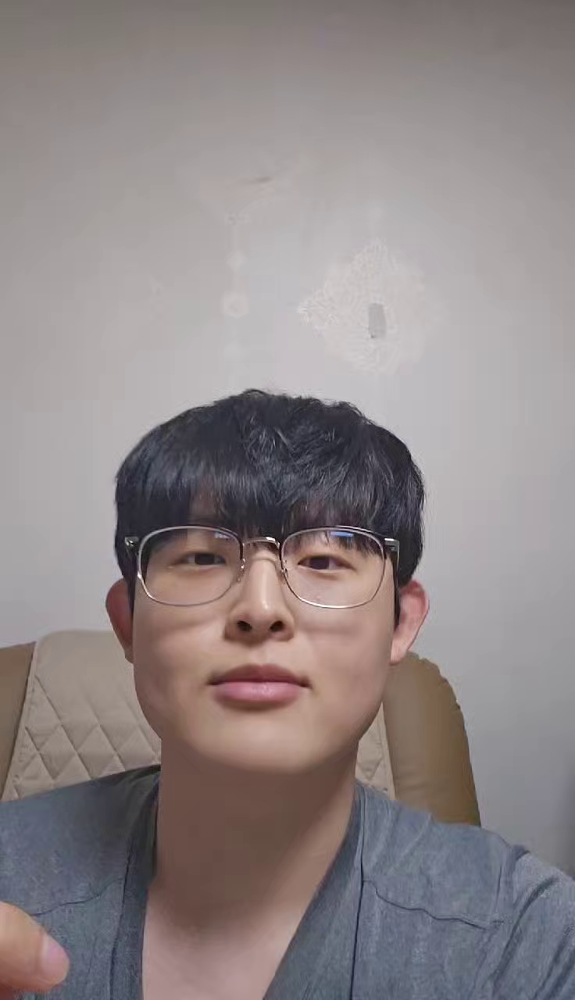


0: 640x384 1 natural, 16.1ms
Speed: 2.7ms preprocess, 16.1ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.1ms
Speed: 2.1ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 11.2ms
Speed: 2.2ms preprocess, 11.2ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 11.0ms
Speed: 2.3ms preprocess, 11.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.0ms
Speed: 2.2ms preprocess, 11.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 12.1ms
Speed: 2.9ms preprocess, 12.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.9ms
Speed: 2.4ms preprocess, 10.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.3ms
Speed: 2.9ms preprocess, 11.3ms inference, 0.7ms postproc

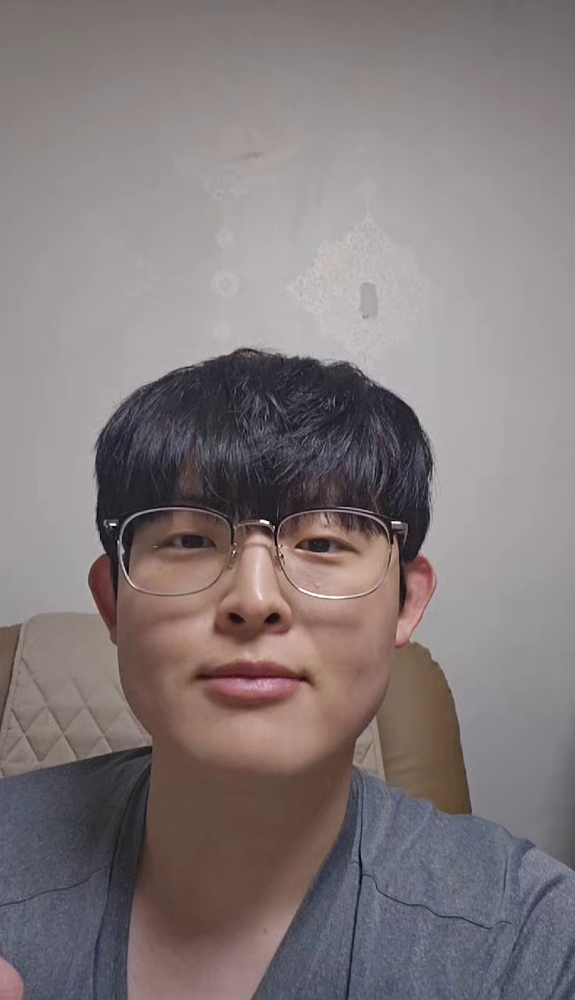


0: 640x384 (no detections), 13.3ms
Speed: 2.3ms preprocess, 13.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.1ms
Speed: 2.2ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 12.3ms
Speed: 3.0ms preprocess, 12.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.4ms
Speed: 2.3ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.7ms
Speed: 2.3ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 13.1ms
Speed: 2.8ms preprocess, 13.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.0ms
Speed: 2.2ms preprocess, 11.0ms i

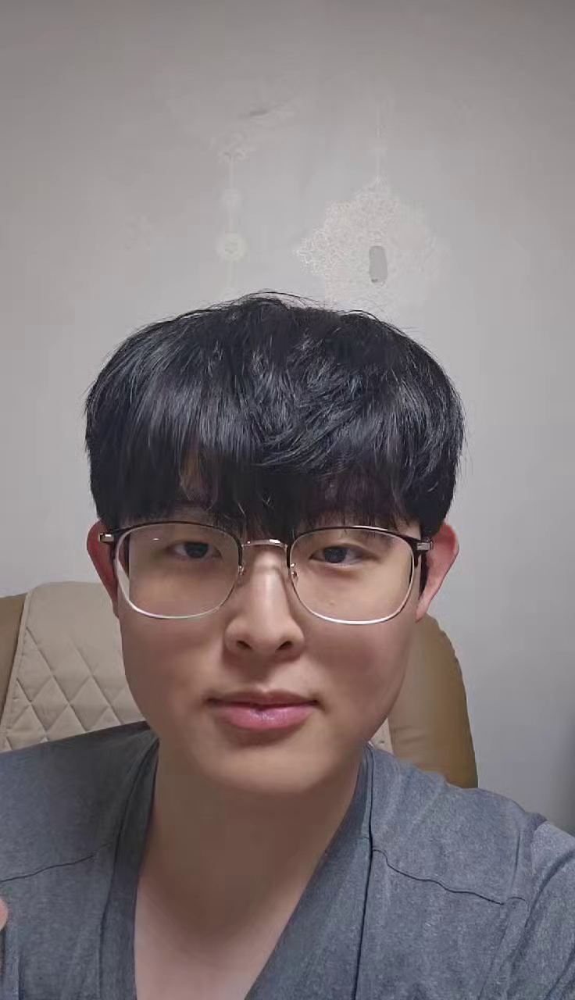


0: 640x384 (no detections), 12.9ms
Speed: 2.9ms preprocess, 12.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.1ms
Speed: 2.3ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 2.3ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 2.3ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 2.2ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 13.7ms
Speed: 2.2ms preprocess, 13.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 12.5ms
Speed: 2.5ms preprocess, 12.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.8ms
Speed: 2.4ms preprocess, 11.8ms i

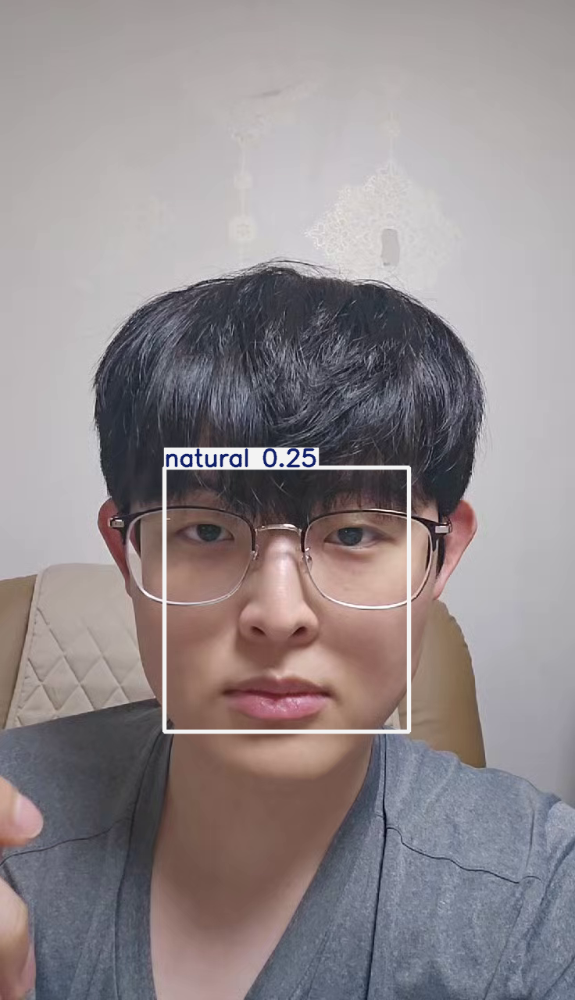


0: 640x384 (no detections), 11.6ms
Speed: 2.2ms preprocess, 11.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.9ms
Speed: 2.7ms preprocess, 10.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.3ms
Speed: 2.3ms preprocess, 10.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.4ms
Speed: 2.2ms preprocess, 10.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 14.2ms
Speed: 2.7ms preprocess, 14.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 9.9ms
Speed: 2.1ms preprocess, 9.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 13.7ms
Speed: 2.8ms preprocess, 13.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.7ms
Speed: 2.2ms preprocess, 10.7ms inf

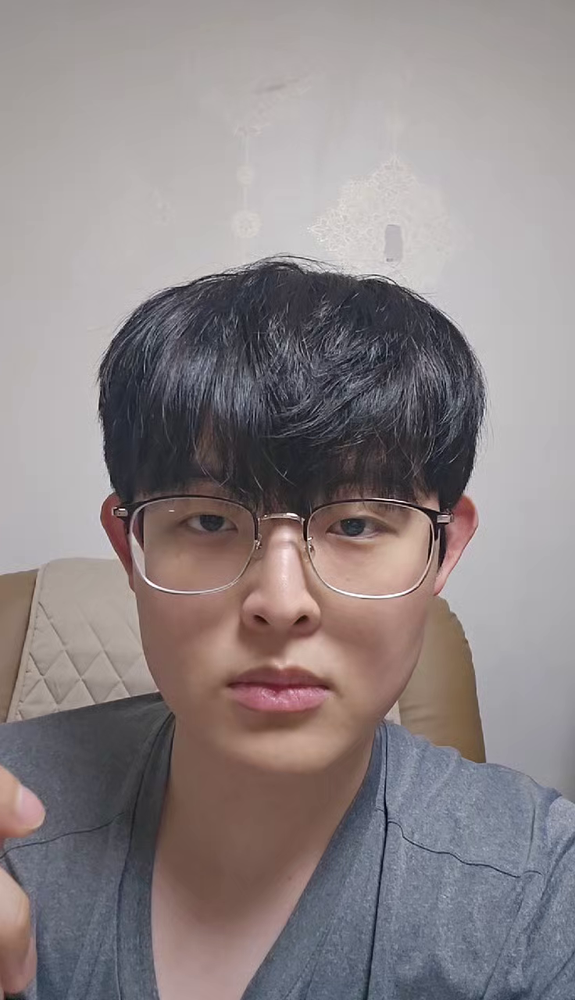


0: 640x384 (no detections), 13.1ms
Speed: 2.1ms preprocess, 13.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.7ms
Speed: 2.3ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.9ms
Speed: 2.2ms preprocess, 10.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.3ms
Speed: 2.1ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 12.3ms
Speed: 2.2ms preprocess, 12.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 13.1ms
Speed: 2.8ms preprocess, 13.1ms i

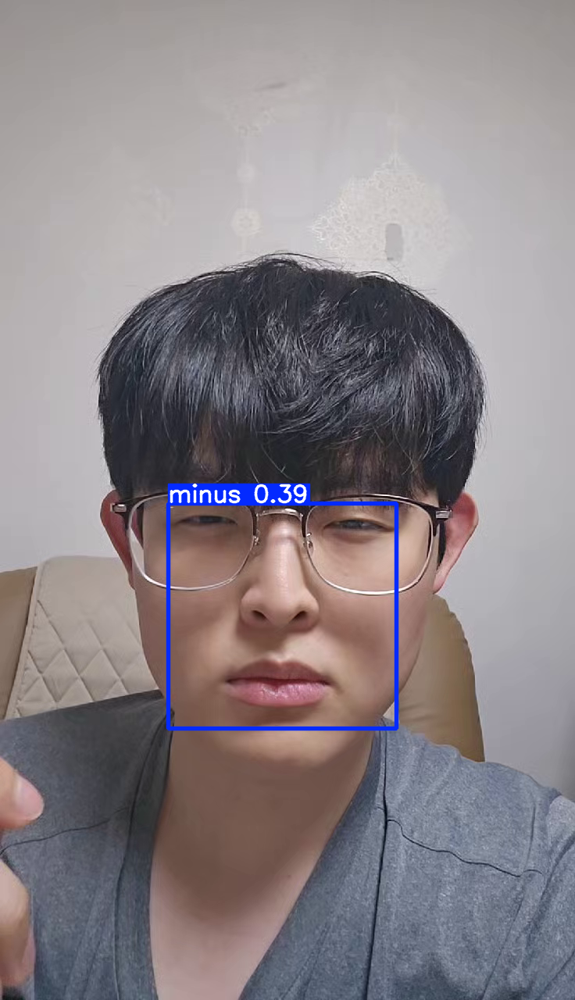


0: 640x384 1 minus, 11.2ms
Speed: 2.0ms preprocess, 11.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 18.0ms
Speed: 2.8ms preprocess, 18.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.3ms
Speed: 2.1ms preprocess, 10.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.4ms
Speed: 2.2ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.7ms
Speed: 2.2ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.8ms
Speed: 2.1ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.5ms
Speed: 2.1ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


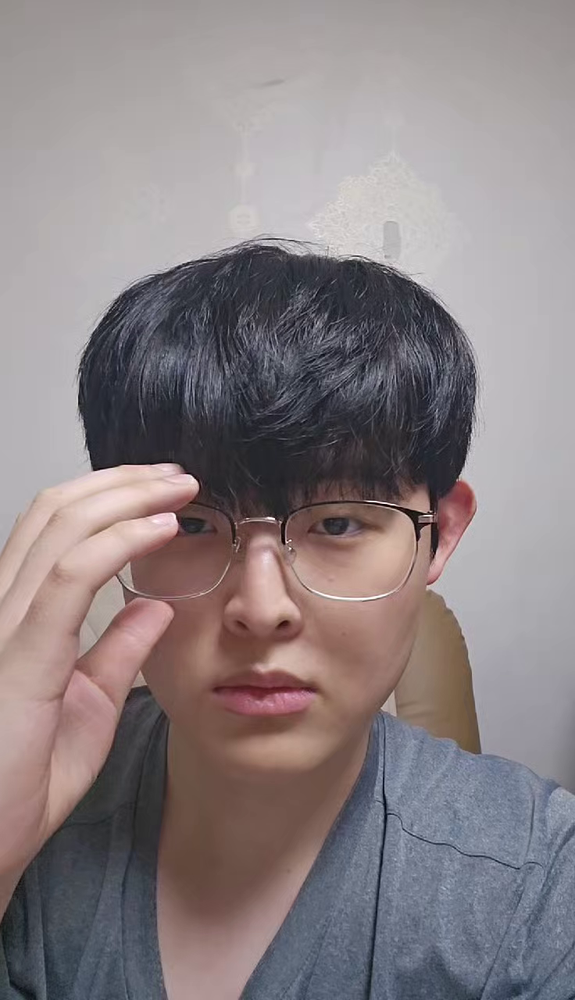


0: 640x384 (no detections), 10.5ms
Speed: 2.3ms preprocess, 10.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.1ms
Speed: 2.2ms preprocess, 11.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.1ms
Speed: 2.2ms preprocess, 10.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.9ms
Speed: 2.3ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.4ms
Speed: 2.2ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 15.3ms
Speed: 2.7ms preprocess, 15.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.7ms
Speed: 2.2ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.2ms
Speed: 2.2ms preprocess, 11.2ms inference, 0.6ms 

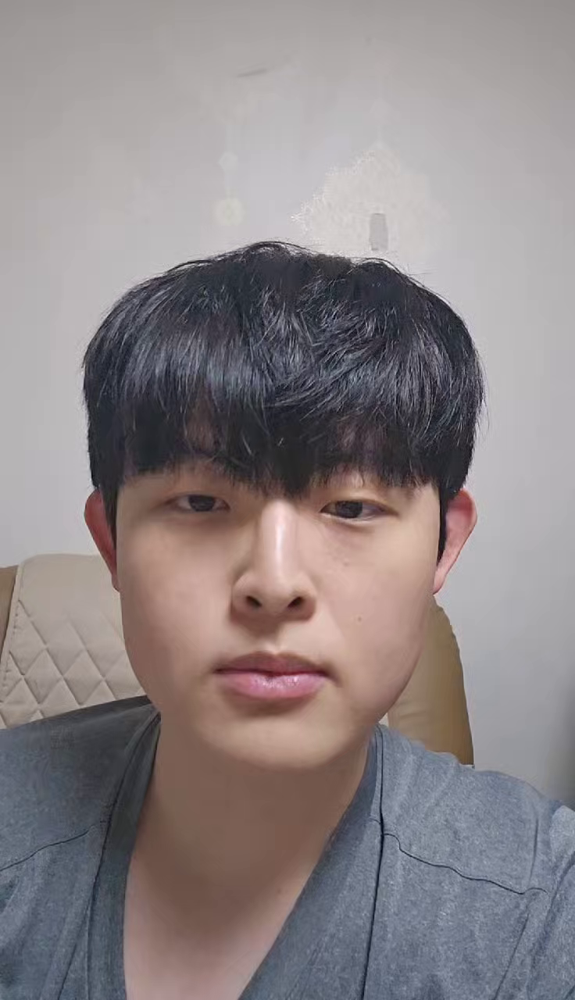


0: 640x384 1 natural, 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.7ms
Speed: 2.3ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 1 natural, 10.6ms
Speed: 2.3ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 13.1ms
Speed: 2.9ms preprocess, 13.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 10.9ms
Speed: 2.2ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.6ms
Speed: 2.1ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 11.0ms
Speed: 2.3ms preprocess, 11.0ms inference, 1.8ms postprocess per image at sh

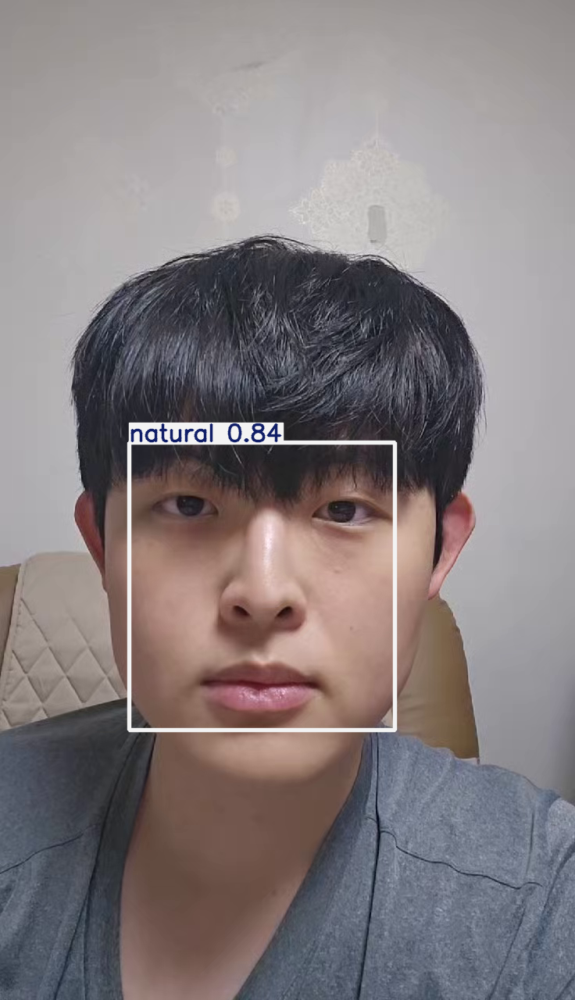


0: 640x384 1 natural, 10.4ms
Speed: 2.1ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.5ms
Speed: 2.1ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.5ms
Speed: 2.8ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.8ms
Speed: 2.2ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.7ms
Speed: 2.2ms preprocess, 10.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.6ms
Speed: 2.1ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (

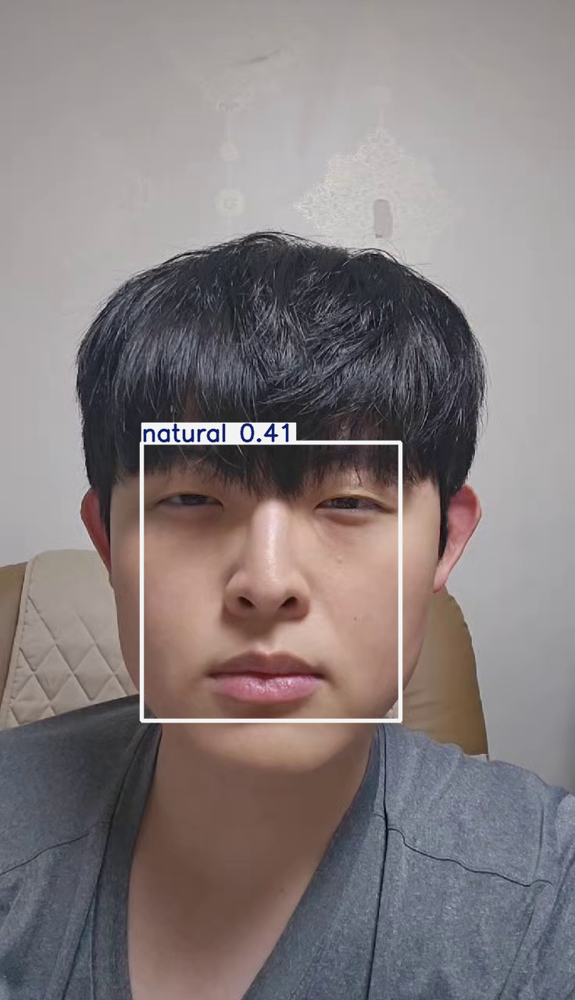


0: 640x384 1 natural, 11.3ms
Speed: 2.2ms preprocess, 11.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 11.3ms
Speed: 2.3ms preprocess, 11.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.3ms
Speed: 2.3ms preprocess, 10.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.5ms
Speed: 2.1ms preprocess, 10.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.9ms
Speed: 2.3ms preprocess, 10.9ms inference, 0.6ms postproc

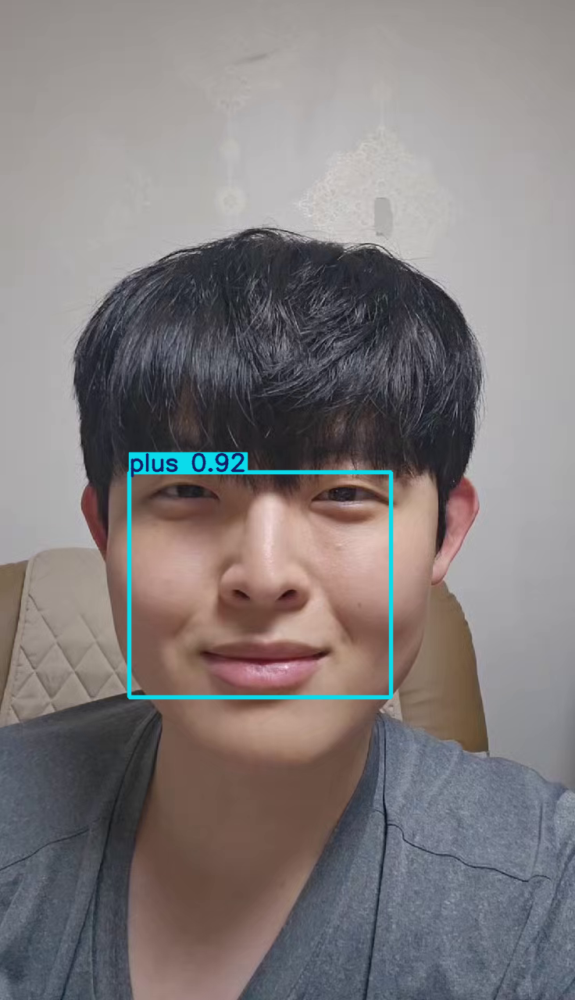


0: 640x384 1 plus, 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.9ms
Speed: 2.5ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 11.0ms
Speed: 2.2ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.4ms
Speed: 2.2ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.6ms
Speed: 2.1ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.2ms
Speed: 2.1ms preprocess, 10.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.7ms
Speed: 2.1ms preprocess, 10.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.2ms
Speed: 2.1ms preprocess, 10.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x

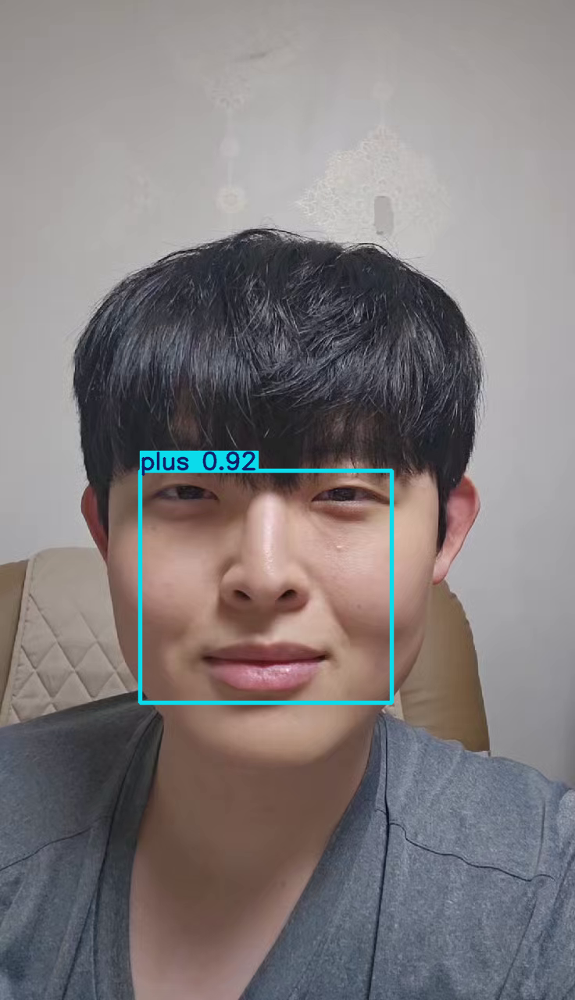


0: 640x384 1 plus, 11.6ms
Speed: 2.1ms preprocess, 11.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.1ms
Speed: 2.2ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.7ms
Speed: 2.4ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.4ms
Speed: 2.2ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.5ms
Speed: 2.2ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 plus, 10.8ms
Speed: 2.1ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x

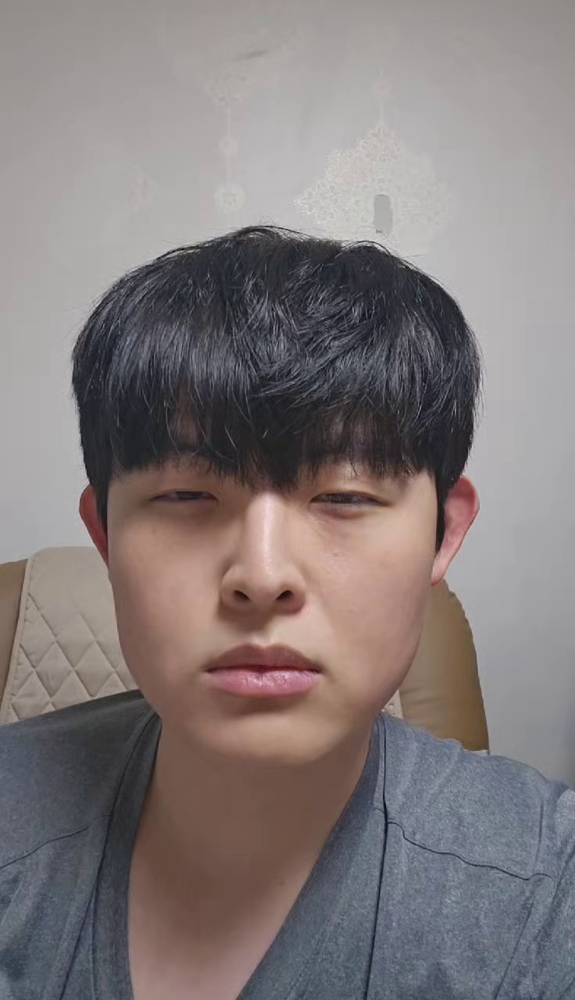


0: 640x384 (no detections), 10.8ms
Speed: 2.4ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 2.2ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.6ms
Speed: 2.8ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.4ms
Speed: 2.2ms preprocess, 11.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.8ms
Speed: 2.2ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.9ms
Speed: 2.2ms preprocess, 10.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.9ms
Speed: 2.2ms preprocess, 10.9ms i

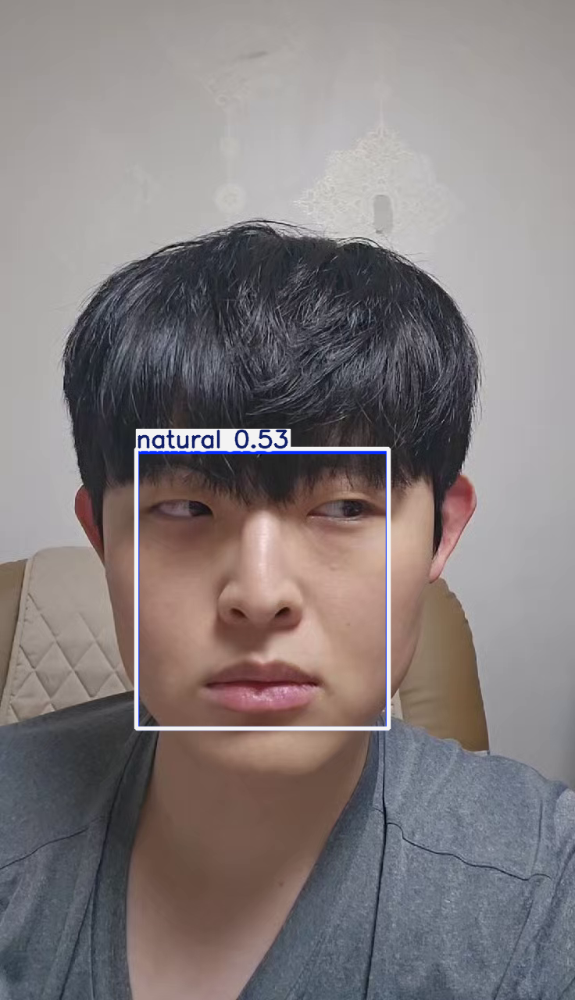


0: 640x384 1 minus, 1 natural, 10.8ms
Speed: 2.1ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 1 natural, 10.7ms
Speed: 2.2ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 1 natural, 11.0ms
Speed: 2.1ms preprocess, 11.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 1 natural, 10.4ms
Speed: 2.1ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 minus, 1 natural, 10.2ms
Speed: 2.1ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.1ms
Speed: 2.1ms preprocess, 10.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 10.6ms
Speed: 2.2ms preprocess, 10.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 1 natural, 14.4ms
Speed: 2.8ms preprocess, 14.4ms infe

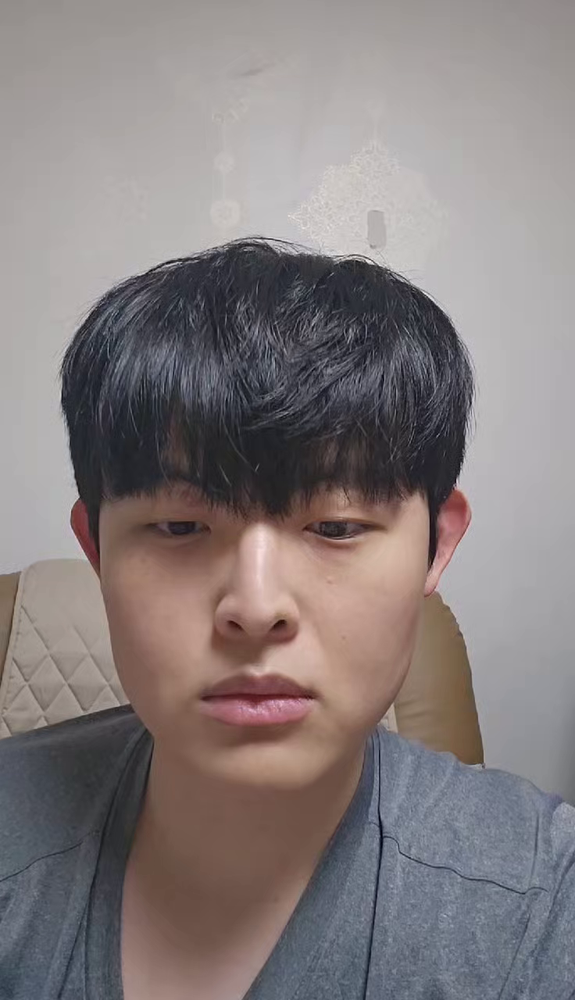


0: 640x384 (no detections), 11.0ms
Speed: 2.1ms preprocess, 11.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.2ms
Speed: 2.2ms preprocess, 10.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 14.0ms
Speed: 2.8ms preprocess, 14.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.1ms
Speed: 2.0ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 12.0ms
Speed: 2.8ms preprocess, 12.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 10.8ms
Speed: 2.2ms preprocess, 10.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 13.5ms
Speed: 2.7ms preprocess, 13.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 384)

0: 640x384 (no detections), 11.2ms
Speed: 2.2ms preprocess, 11.2ms i

In [ ]:
from ultralytics import YOLO
import cv2
from google.colab.patches import cv2_imshow

# 학습된 YOLO 모델 경로
model_path = "/content/drive/MyDrive/face_emotion/training_results3/yolov8_my_model_finetune/weights/best.pt"

# 비디오 파일 경로 (예측할 영상 파일 경로)
video_path = "/content/KakaoTalk_20250127_235849512.mp4"

# 결과 저장 경로
output_video_path = "/content/drive/MyDrive/face_emotion/finetuning_Result4.mp4"

# YOLO 모델 로드
model = YOLO(model_path)

# 비디오 캡처 객체 생성
cap = cv2.VideoCapture(video_path)

# 비디오 저장 설정
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # MP4 코덱
fps = int(cap.get(cv2.CAP_PROP_FPS))      # 원본 영상 FPS
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

# 비디오 프레임 예측
frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # 비디오 끝

    # YOLO 모델로 예측
    results = model(frame)

    # 예측된 결과를 프레임에 그리기
    annotated_frame = results[0].plot()

    # 결과를 저장
    out.write(annotated_frame)

    # 프레임 출력 (옵션)
    if frame_count % 30 == 0:  # 30 프레임마다 한 번 출력
        print(f"Processing frame: {frame_count}")
        cv2_imshow(annotated_frame)

    frame_count += 1

# 자원 해제
cap.release()
out.release()

print(f"예측된 영상이 저장되었습니다: {output_video_path}")
